In [32]:
import os
import random
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy

# FILTROS DE SUAVIZADO

In [3]:
def blur_average(img, ksize=5):
    """Suavizado por media"""
    return cv2.blur(img, (ksize, ksize))

def blur_gaussian(img, ksize=5, sigma=0):
    """Suavizado gaussiano"""
    return cv2.GaussianBlur(img, (ksize, ksize), sigma)

def blur_median(img, ksize=5):
    """Filtro de mediana"""
    return cv2.medianBlur(img, ksize)

# FILTROS DE REALCE DE BORDES

In [4]:
def sharpen(img):
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    return cv2.filter2D(img, -1, kernel)

def edge_enhance_laplacian(img):
    lap = cv2.Laplacian(img, cv2.CV_64F)
    lap = cv2.convertScaleAbs(lap)
    return cv2.addWeighted(img, 1, lap, 1, 0)

# FILTROS DE DETECCIÓN DE BORDES 

In [5]:
def edge_sobel(img, orient='x'):
    if orient == 'x':
        sob = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    else:
        sob = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    return cv2.convertScaleAbs(sob)

def edge_canny(img, threshold1=100, threshold2=200):
    if len(img.shape) == 3:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img
    return cv2.Canny(img_gray, threshold1, threshold2)

# FILTROS MORFOLÓGICOS

In [6]:
def morph_erosion(img, ksize=3, iterations=1):
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.erode(img, kernel, iterations=iterations)

def morph_dilation(img, ksize=3, iterations=1):
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.dilate(img, kernel, iterations=iterations)

def morph_opening(img, ksize=3):
    """Apertura = Erosión seguida de Dilatación"""
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)

def morph_closing(img, ksize=3):
    """Cierre = Dilatación seguida de Erosión"""
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)

def morph_gradient(img, ksize=3):
    """Diferencia entre dilatación y erosión"""
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)

def morph_tophat(img, ksize=3):
    """Resalta pequeños objetos brillantes"""
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)

def morph_blackhat(img, ksize=3):
    """Resalta pequeños objetos oscuros"""
    kernel = np.ones((ksize, ksize), np.uint8)
    return cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)


# MÉTRICAS

In [28]:
def to_gray(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    return img

def compute_psnr(img1, img2):
    img1 = img1.astype(np.float32)
    img2 = img2.astype(np.float32)

    mse = np.mean((img1 - img2) ** 2)
    if mse == 0:
        return float('inf')

    return 20 * np.log10(255.0 / np.sqrt(mse))


def compute_ssim(img1, img2):
    gray1 = to_gray(img1)
    gray2 = to_gray(img2)
    return ssim(gray1, gray2)

def compute_entropy(img):
    gray = to_gray(img)
    return shannon_entropy(gray)

def compute_epi(original, transformed):
    gray_o = to_gray(original)
    gray_t = to_gray(transformed)

    edges_o = cv2.Canny(gray_o, 100, 200)
    edges_t = cv2.Canny(gray_t, 100, 200)

    intersection = np.logical_and(edges_o, edges_t).sum()
    total_edges = edges_o.sum()

    if total_edges == 0:
        return 0.0

    return intersection / total_edges



In [11]:
def select_random_images():
    random.seed(42)

    base_dir = "../data"
    subfolders = ["industrial", "medical", "satelital"]
    images_per_class = 4

    images_path = []

    for folder in subfolders:
        folder_path = os.path.join(base_dir, folder)
        all_images = [
            f for f in os.listdir(folder_path)
            if f.lower().endswith((".jpg", ".jpeg", ".png"))
        ]
        chosen = random.sample(all_images, images_per_class)
        images_path.extend([os.path.join(folder_path, img) for img in chosen])

    return images_path

In [38]:
def transformations():
    images_list = select_random_images()

    transformations_names = [
        "Original", "Blur_Average", "Gaussian_Blur", "Median_Blur", "Sharpen",
        "Laplacian_Edge_Enhance", "Sobel_Edge", "Canny_Edge",
        "Morph_Erosion", "Morph_Dilation", "Morph_Opening", "Morph_Closing",
        "Morph_Gradient", "Morph_TopHat", "Morph_BlackHat"
    ]

    result_dir = "../data/result"
    os.makedirs(result_dir, exist_ok=True)

    ncols = len(transformations_names)
    nrows = len(images_list)

    fig, axes = plt.subplots(
        nrows=nrows,
        ncols=ncols,
        figsize=(ncols * 5, nrows * 5)
    )

    axes = np.array(axes)
    if axes.ndim == 1:
        axes = axes.reshape((nrows, ncols))

    # 🔹 Aquí guardamos TODAS las métricas
    results = []

    for row_idx, image_path in enumerate(images_list):
        img = np.array(Image.open(image_path).convert("RGB"))
        base_name = os.path.splitext(os.path.basename(image_path))[0]

        transforms = [
            img,
            blur_average(img),
            blur_gaussian(img),
            blur_median(img),
            sharpen(img),
            edge_enhance_laplacian(img),
            edge_sobel(img),
            edge_canny(img),
            morph_erosion(img),
            morph_dilation(img),
            morph_opening(img),
            morph_closing(img),
            morph_gradient(img),
            morph_tophat(img),
            morph_blackhat(img),
        ]

        for col_idx, (t_img, t_name) in enumerate(zip(transforms, transformations_names)):

            # 🖼️ Mostrar imagen
            axes[row_idx, col_idx].imshow(t_img, cmap="gray")
            axes[row_idx, col_idx].set_title(t_name, fontsize=18)
            axes[row_idx, col_idx].axis("off")

            # 💾 Guardar imagen
            save_name = f"{row_idx+1}_{col_idx+1}_{base_name}_{t_name}.png"
            Image.fromarray(t_img).save(os.path.join(result_dir, save_name))

            # 📊 MÉTRICAS (excepto original)
            if t_name != "Original":
                metrics = {
                    "Image": base_name,
                    "Filter": t_name,
                    "PSNR": np.nan,
                    "SSIM": np.nan,
                    "Entropy": np.nan,
                    "EPI": np.nan
                }

                # Suavizado / realce
                if t_name in ["Blur_Average", "Gaussian_Blur", "Median_Blur", "Sharpen"]:
                    metrics["PSNR"] = compute_psnr(img, t_img)
                    metrics["SSIM"] = compute_ssim(img, t_img)
                    metrics["Entropy"] = compute_entropy(t_img)

                # Bordes
                elif t_name in ["Laplacian_Edge_Enhance", "Sobel_Edge", "Canny_Edge", "Morph_Gradient"]:
                    metrics["EPI"] = compute_epi(img, t_img)
                    metrics["Entropy"] = compute_entropy(t_img)

                # Morfológicos
                elif "Morph" in t_name:
                    metrics["SSIM"] = compute_ssim(img, t_img)
                    metrics["Entropy"] = compute_entropy(t_img)

                results.append(metrics)

    plt.tight_layout()
    plt.show()

    # =========================
    # 📊 DATAFRAME FINAL
    # =========================

    df = pd.DataFrame(results)

    df_mean = (
        df
        .groupby("Filter", as_index=False)
        .mean(numeric_only=True)
        .round(4)
    )

    print("\n========== METRICS SUMMARY (MEAN PER FILTER) ==========\n")
    display(df_mean)

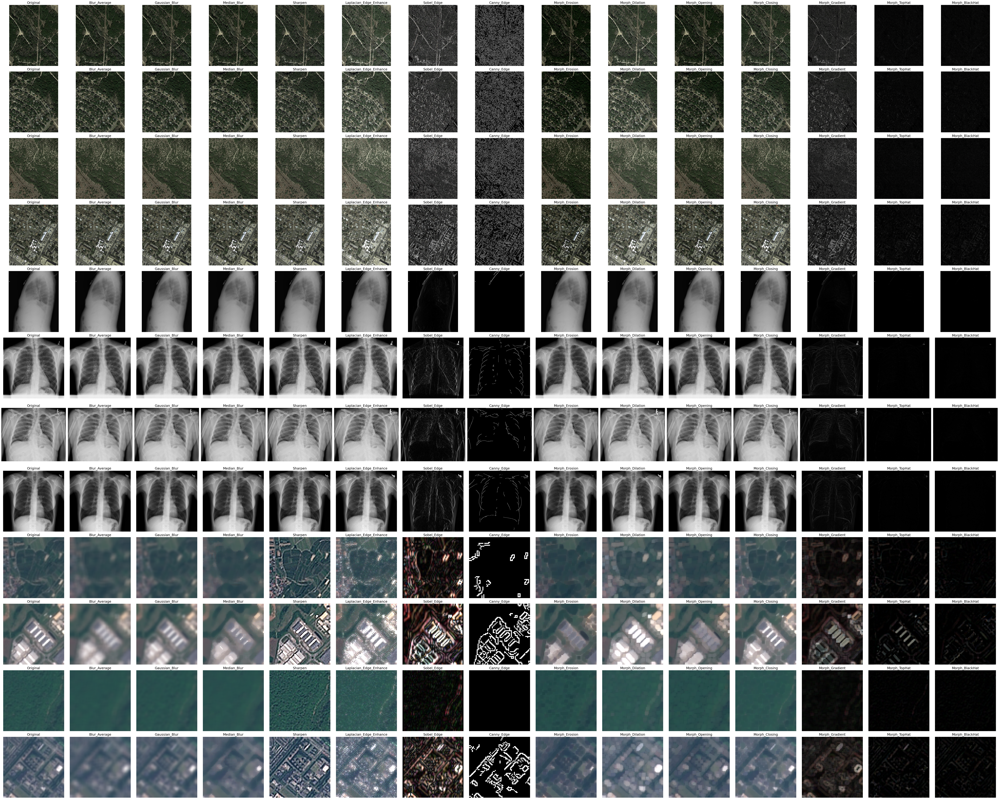


========== METRICS SUMMARY (MEAN PER FILTER) ==========



,Filter,PSNR,SSIM,Entropy,EPI
0,Blur_Average,30.4629,0.7624,6.3867,NaN
1,Canny_Edge,NaN,NaN,0.4027,0.0003
2,Gaussian_Blur,33.2386,0.8721,6.4513,NaN
3,Laplacian_Edge_Enhance,NaN,NaN,6.8800,0.0022
4,Median_Blur,31.3400,0.7865,6.3821,NaN
5,Morph_BlackHat,NaN,-0.0060,2.9265,NaN
6,Morph_Closing,NaN,0.9035,6.5161,NaN
7,Morph_Dilation,NaN,0.7637,6.6140,NaN
8,Morph_Erosion,NaN,0.7343,6.3296,NaN
9,Morph_Gradient,NaN,NaN,5.3264,0.0003


In [40]:
transformations()

In [39]:
RESULT_DIR = "../data/result"
IMAGE_EXTENSIONS = (".png", ".jpg", ".jpeg")

if not os.path.exists(RESULT_DIR):
    print(f"La carpeta no existe: {RESULT_DIR}")
    exit()

deleted = 0

for filename in os.listdir(RESULT_DIR):
    if filename.lower().endswith(IMAGE_EXTENSIONS):
        file_path = os.path.join(RESULT_DIR, filename)
        os.remove(file_path)
        deleted += 1

print(f"Imágenes eliminadas: {deleted}")

Imágenes eliminadas: 180
